In [70]:
import os
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from keras.applications import VGG16
# 定义一个Dense层的分类器
from keras import layers
from keras import models
from keras import optimizers
from keras.preprocessing import image
import numpy as np
import os

In [2]:
train_dir = "./data/dogs-vs-cats/cats_and_dogs_small/train/"
validation_dir = "./data/dogs-vs-cats/cats_and_dogs_small/validation/"
test_dir = "./data/dogs-vs-cats/cats_and_dogs_small/test/"

In [3]:
conv_base = VGG16(include_top=False, weights='imagenet', input_shape=(150, 150, 3))

In [4]:
conv_base.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 150, 150, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
__________

In [5]:
conv_base.trainable = True
set_trainable = False
for layer in conv_base.layers:
    if layer.name == "block5_conv1":
        set_trainable = True
    if set_trainable is True:
        layer.trainable = True
    else:
        layer.trainable = False

In [6]:
model = models.Sequential()
model.add(conv_base)
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

In [7]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_1 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)               1048704   
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 129       
Total params: 15,763,521
Trainable params: 8,128,257
Non-trainable params: 7,635,264
_________________________________________________________________


In [10]:
traindatagen = ImageDataGenerator(
    rescale=1.0/255,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=40,
    horizontal_flip=True,
    fill_mode='nearest'
)

In [11]:
train_generator = traindatagen.flow_from_directory(train_dir, class_mode='binary', target_size=(150, 150), batch_size=20)

Found 2000 images belonging to 2 classes.


In [12]:
test_datagen = ImageDataGenerator(rescale=1./255)

In [14]:
validation_generator = test_datagen.flow_from_directory(validation_dir, class_mode='binary', target_size=(150, 150), batch_size=20)

Found 1000 images belonging to 2 classes.


In [15]:
test_generator = test_datagen.flow_from_directory(test_dir, class_mode='binary', target_size=(150, 150), batch_size=20)

Found 1000 images belonging to 2 classes.


In [16]:
model.compile(optimizer=optimizers.RMSprop(lr=1e-5), loss='binary_crossentropy', metrics=['acc'])

In [17]:
history = model.fit_generator(train_generator, steps_per_epoch=100, epochs=30, validation_data=validation_generator, validation_steps=50)

Epoch 1/30
100/100 [==============================] - 18s 179ms/step - loss: 0.5474 - acc: 0.7260 - val_loss: 0.3832 - val_acc: 0.8220
Epoch 2/30
100/100 [==============================] - 16s 164ms/step - loss: 0.3990 - acc: 0.8210 - val_loss: 0.2647 - val_acc: 0.8810
Epoch 3/30
100/100 [==============================] - 16s 163ms/step - loss: 0.3402 - acc: 0.8450 - val_loss: 0.2379 - val_acc: 0.8860
Epoch 4/30
100/100 [==============================] - 16s 163ms/step - loss: 0.2937 - acc: 0.8760 - val_loss: 0.2199 - val_acc: 0.8980
Epoch 5/30
100/100 [==============================] - 16s 164ms/step - loss: 0.2838 - acc: 0.8740 - val_loss: 0.1999 - val_acc: 0.9120
Epoch 6/30
100/100 [==============================] - 16s 163ms/step - loss: 0.2682 - acc: 0.8765 - val_loss: 0.1915 - val_acc: 0.9160
Epoch 7/30
100/100 [==============================] - 16s 164ms/step - loss: 0.2414 - acc: 0.8950 - val_loss: 0.1881 - val_acc: 0.9130
Epoch 8/30
100/100 [==============================] - 1

In [19]:
test_loss, test_acc = model.evaluate_generator(test_generator, steps=50)
print(test_loss, test_acc)

0.2753977895900607 0.9209999930858612


In [24]:
model.save("cats_and_dogs_small_2.h5")

In [25]:
from keras.models import load_model

In [26]:
model = load_model("cats_and_dogs_small_2.h5")

In [27]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_1 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 128)               1048704   
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 129       
Total params: 15,763,521
Trainable params: 8,128,257
Non-trainable params: 7,635,264
_________________________________________________________________


In [65]:
vgg16_model = VGG16(weights='imagenet', include_top=False)

In [67]:
layer_outputs = [layer.output for layer in vgg16_model.layers[:8]]

In [68]:
model = models.Model(inputs=vgg16_model.input, outputs=layer_outputs)

In [94]:
img = image.load_img(os.path.join(test_dir, "cats/cat.1690.jpg"), target_size=(150, 150))

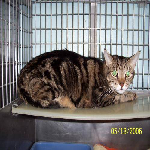

In [95]:
img

In [96]:
image_tensor = image.img_to_array(img)

In [97]:
image_tensor.shape

(150, 150, 3)

In [98]:
image_tensor = np.expand_dims(image_tensor, axis=0)

In [99]:
image_tensor.shape

(1, 150, 150, 3)

In [100]:
image_tensor /= 255.

In [101]:
image_tensor.shape

(1, 150, 150, 3)

In [103]:
activations = model.predict(image_tensor)

In [107]:
for activation_layer in activations:
    print(activation_layer.shape)

(1, 150, 150, 3)
(1, 150, 150, 64)
(1, 150, 150, 64)
(1, 75, 75, 64)
(1, 75, 75, 128)
(1, 75, 75, 128)
(1, 37, 37, 128)
(1, 37, 37, 256)


In [110]:
layer_names = [layer.name for layer in model.layers[1:8]]

block1_conv1 64
block1_conv2 64
block1_pool 64
block2_conv1 128
block2_conv2 128
block2_pool 128
block3_conv1 256


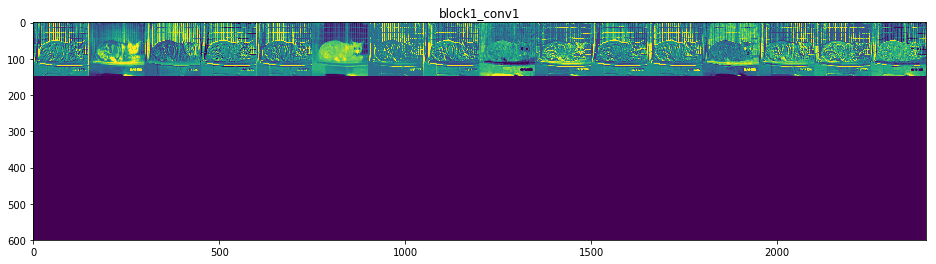

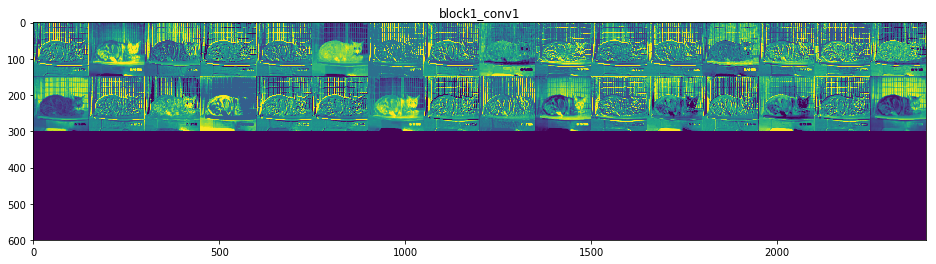

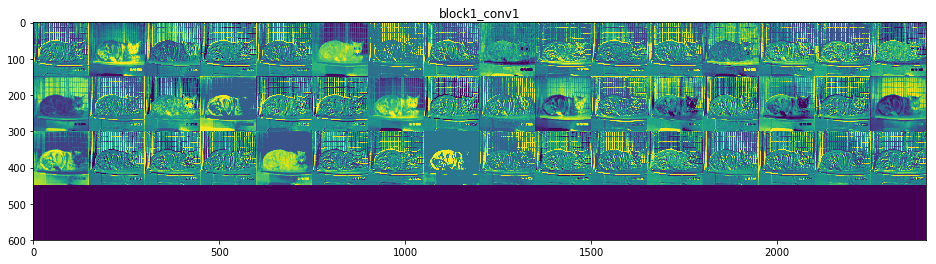

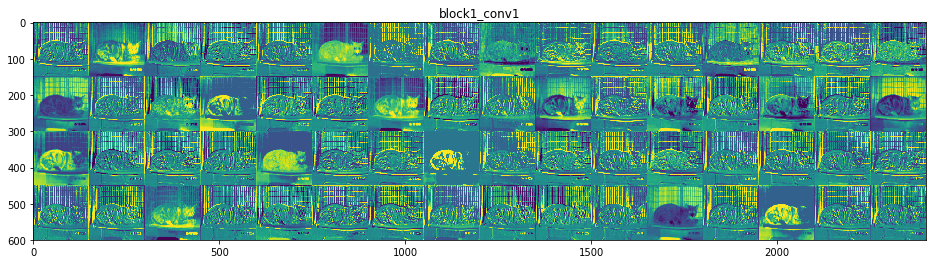

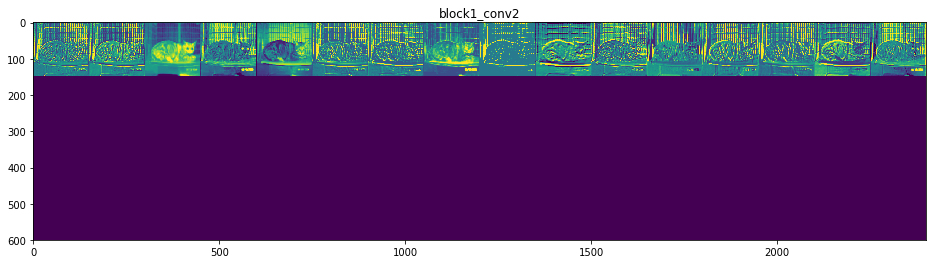

...

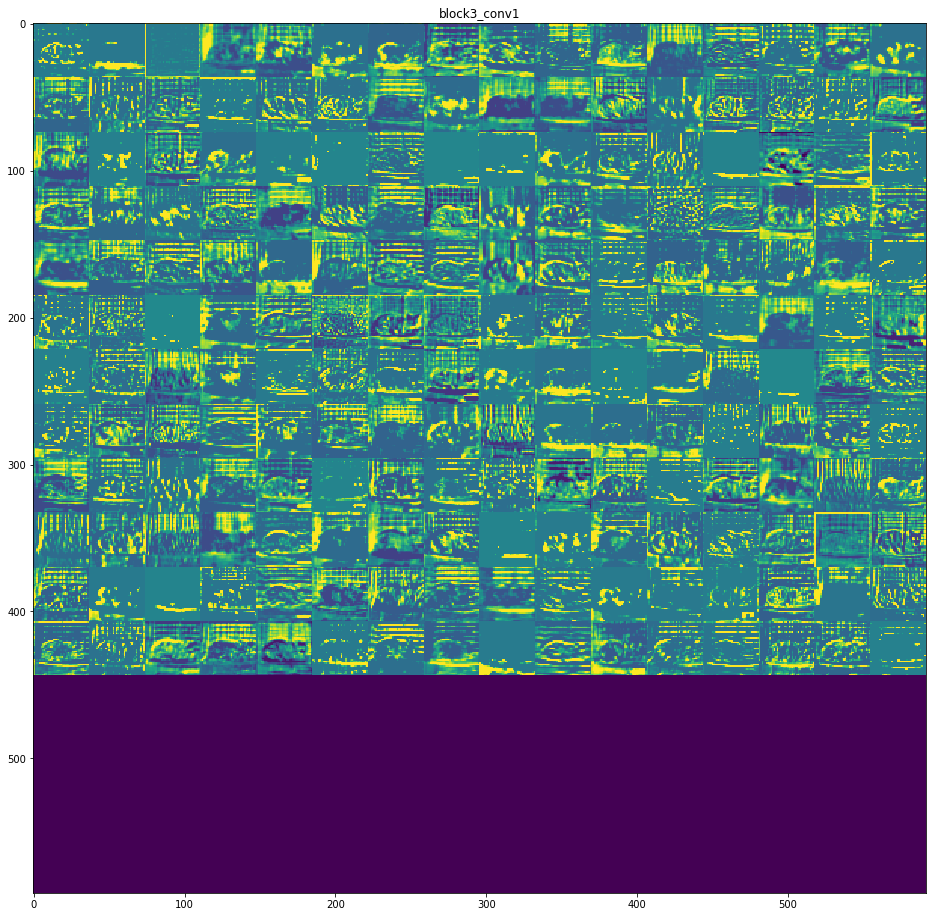

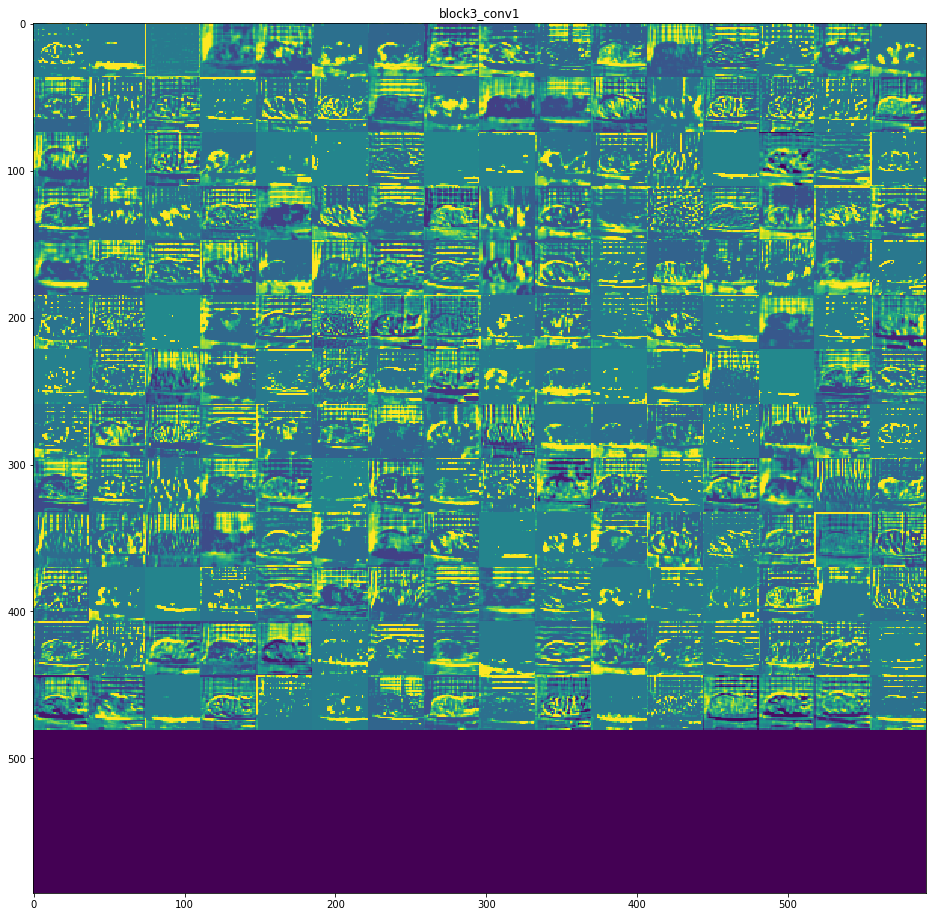

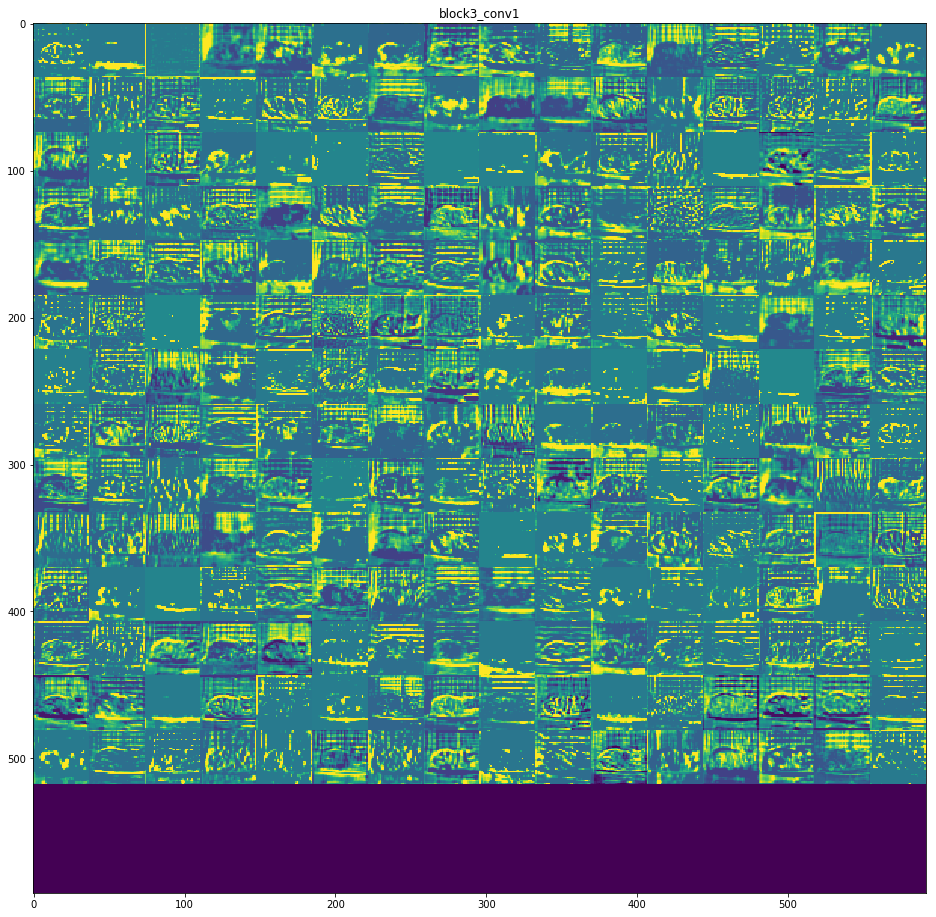

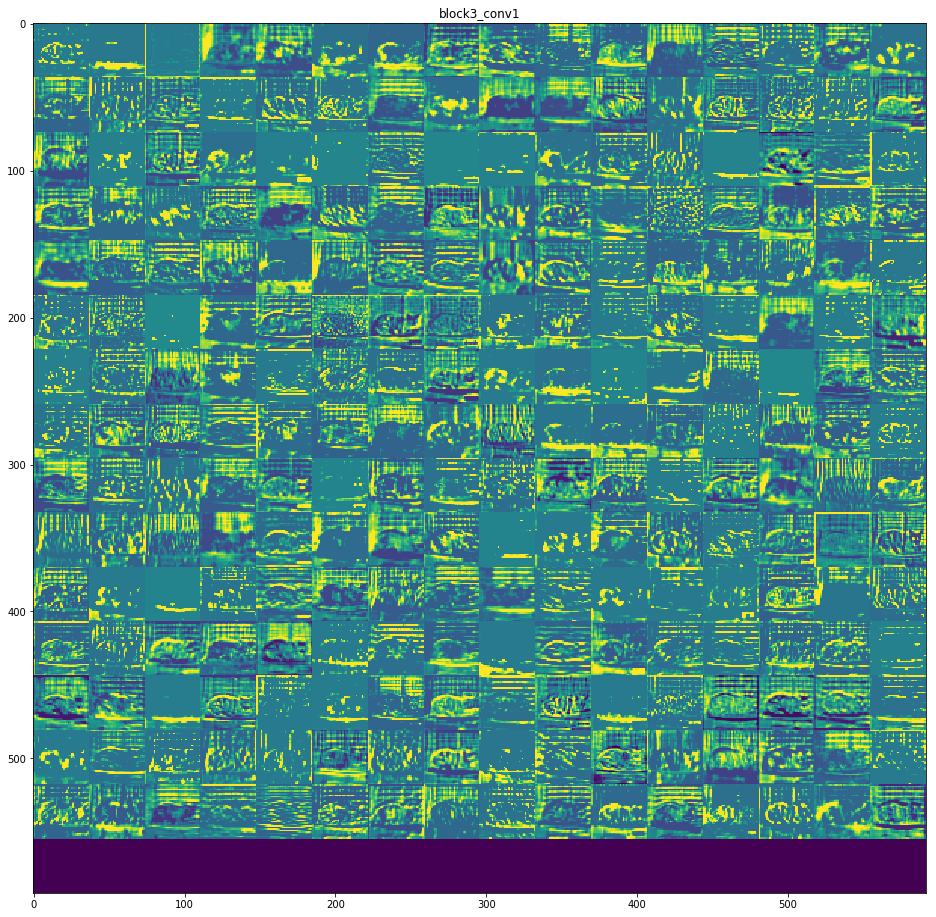

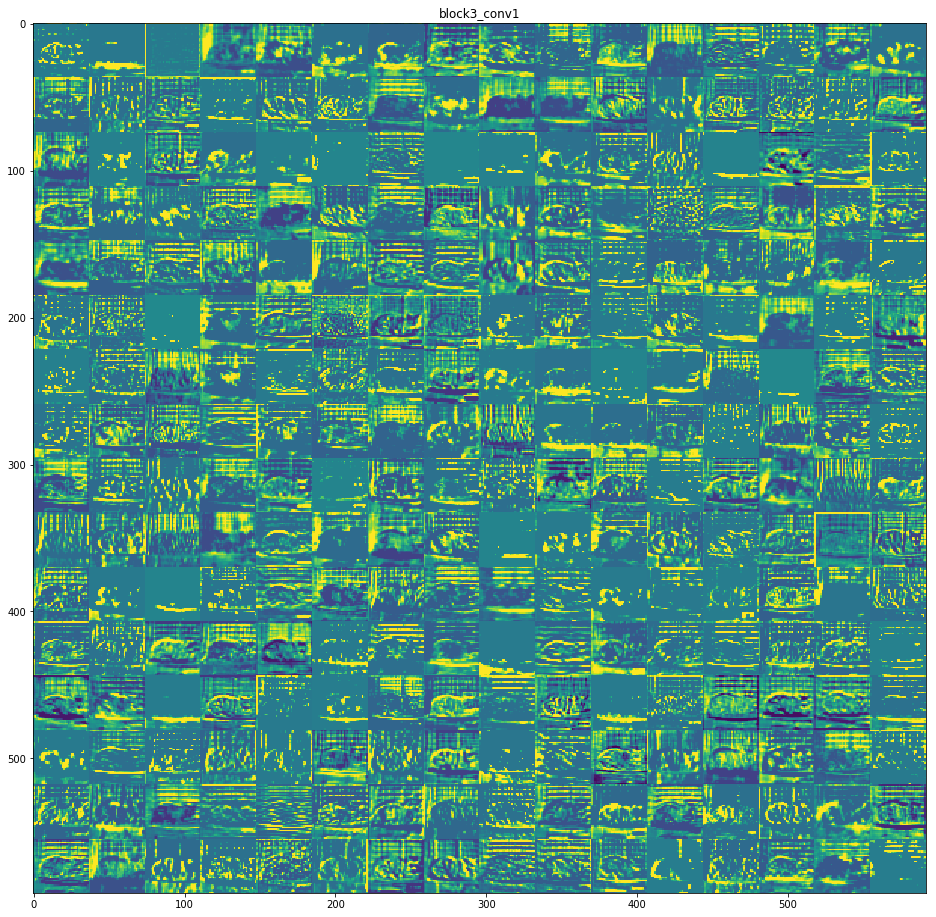

In [124]:
images_per_row = 16
for name, activation in zip(layer_names, activations[1:8]):
    n_features = activation.shape[-1]
    print(name, n_features)
    # 特征图数 // 每行图片数 = 多少行
    size = activation.shape[1]
    cols = n_features // images_per_row
    display_grid = np.zeros((cols*size, images_per_row*size))
    for col in range(cols):
        for row in range(images_per_row):
            # row每行的第几个
            # 行数* 每行的个数 + 每行的第几个 = 特征号
            channel_img = activation[0,:, :, col*images_per_row+row]
            # 对图像变换处理:归一化
            channel_img -= channel_img.mean()
            channel_img /= channel_img.std()
            channel_img *= 64
            channel_img += 128
            channel_img = np.clip(channel_img, 0, 255).astype('uint8')
            display_grid[col*size:(col+1)*size, row*size:(row+1)*size] = channel_img
            
        scale = 1./size
        plt.figure(figsize=(scale*display_grid.shape[1], scale*display_grid.shape[0]))
        plt.grid(False)
        plt.title(name)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')